In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

### Imports

In [3]:
import pandas as pd
import pyarrow.parquet as pq
import matplotlib.pyplot as plt

import numpy as np
from numpy.fft import *
from scipy.signal import butter
from scipy import fftpack
from scipy import signal
import pywt

from fft_dwt import high_pass, maddest, denoise_signal

from scipy.signal import find_peaks, peak_widths

### Load data

In [35]:
%%time
train_df = pq.read_pandas("data/train.parquet").to_pandas()
meta_tr = pd.read_csv("data/metadata_train.csv")

CPU times: user 31.9 s, sys: 9.05 s, total: 41 s
Wall time: 16.6 s


Pick only 10 signals from target=0 and same from target=1:

In [42]:
nn = 10
i_signals_0 = meta_tr[meta_tr.target==0].signal_id.values[:nn]
i_signals_1 = meta_tr[meta_tr.target==1].signal_id.values[:nn]

Now,
`i_signals_0` = 1d-numpy array of signal_ids with target=0
`i_signals_1` = 1d-numpy array of signal_ids with target=1

In [46]:
train_df_0 = train_df.iloc[:, i_signals_0].T
train_df_1 = train_df.iloc[:, i_signals_1].T
del train_df

### Apply high-pass filtering and signal denoising

In [47]:
# raw signal to high-pass signal with threshold 1e4
hp_0   = train_df_0.apply(lambda x: high_pass(x, 1e4), axis=1)
hp_0_d = hp_0.apply(denoise_signal, axis=1)

hp_1   = train_df_1.apply(lambda x: high_pass(x, 1e4), axis=1)
hp_1_d = hp_1.apply(denoise_signal, axis=1)

Now,
* `hp_0` = high-pass signal with target=0
* `hp_1` = high-pass signal with target=1
* `hp_d_0` = high-pass signal with denoising, and with target=0
* `hp_d_1` = high-pass signal with denoising, and with target=1

### Plot signals: target = 0

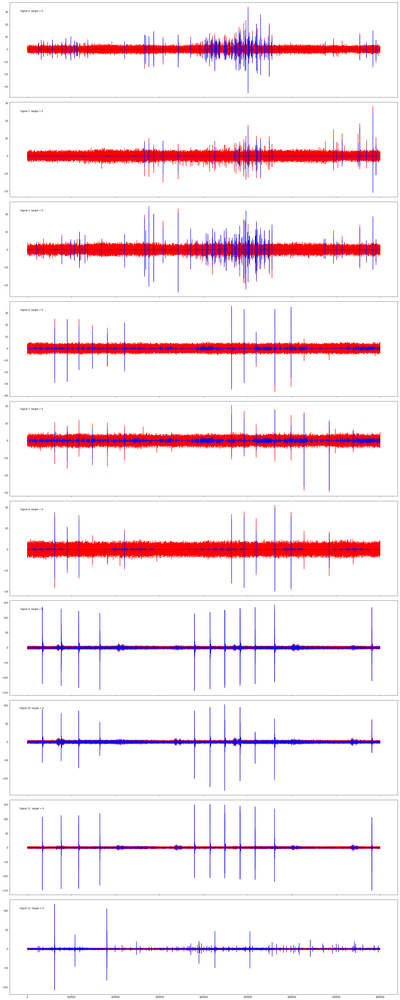

In [95]:
fig, axs = plt.subplots(n, 1, figsize=(24, 6*n), facecolor='w', edgecolor='k', sharex=True)
plt.tight_layout()
axs = axs.ravel()
for i, j in enumerate(i_signals_0):
    axs[i].plot(hp_0.iloc[i, ], color='red')
    axs[i].plot(hp_0_d.iloc[i, ], color='blue')
    axs[i].text(10000, 0.90*max(hp_0.iloc[i, ].max(), hp_0_d.iloc[i, ].max()), f'Signal {j}: target = {meta_tr.iloc[j, :].target}', horizontalalignment='center', verticalalignment='center')

### Plot signals: target = 1

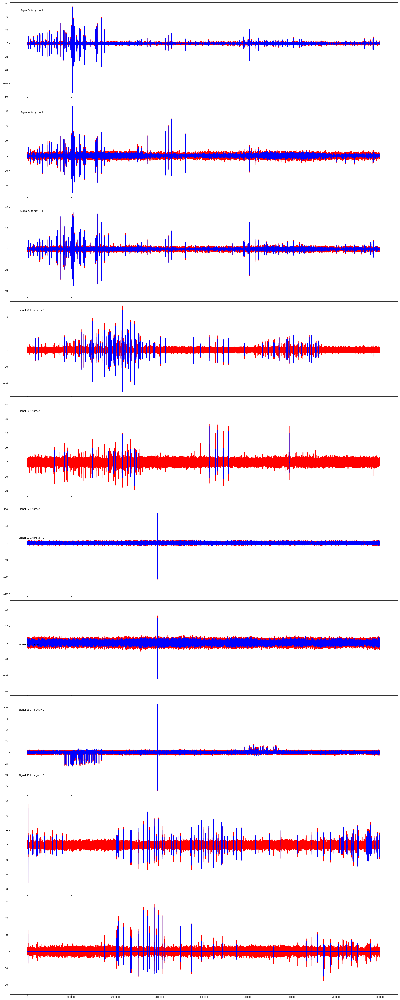

In [94]:
fig, axs = plt.subplots(n, 1, figsize=(24, 6*n), facecolor='w', edgecolor='k', sharex=True)
plt.tight_layout()
axs = axs.ravel()
for i, j in enumerate(i_signals_1):
    axs[i].plot(hp_1.iloc[i, ], color='red')
    axs[i].plot(hp_1_d.iloc[i, ], color='blue')
    axs[i].text(10000, 0.90*max(hp_1.iloc[i, ].max(), hp_0_d.iloc[i, ].max()), f'Signal {j}: target = {meta_tr.iloc[j, :].target}', horizontalalignment='center', verticalalignment='center')

### Plot peaks: target = 0

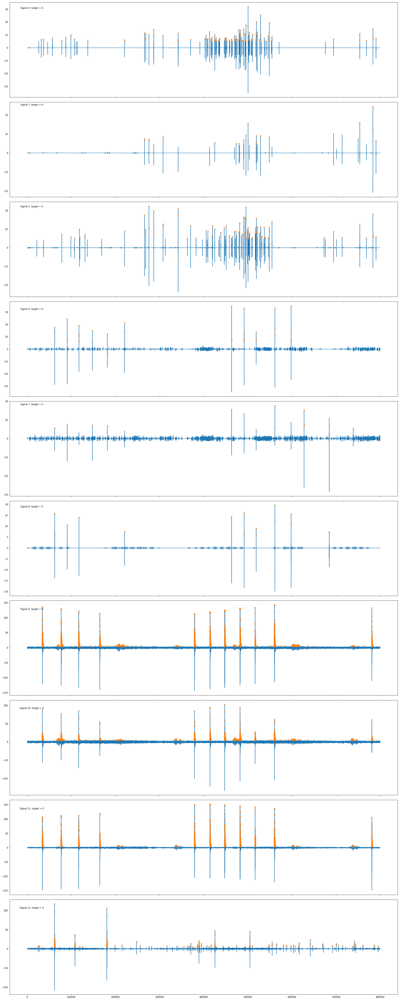

In [93]:
n=nn
fig, axs = plt.subplots(n, 1, figsize=(24, 6*n), facecolor='w', edgecolor='k', sharex=True)
plt.tight_layout()
axs = axs.ravel()
for i, j in enumerate(i_signals_0[:n]):
    peaks, _ = find_peaks(hp_0_d.values[i, :], height=5)
    axs[i].plot(hp_0_d.values[i, :])
    axs[i].plot(peaks, hp_0_d.values[i, :][peaks],"x")
    axs[i].text(10000, 0.90*max(hp_0.iloc[i, ].max(), hp_0_d.iloc[i, ].max()), f'Signal {j}: target = {meta_tr.iloc[j, :].target}', horizontalalignment='center', verticalalignment='center')

### Plot peaks: target=1

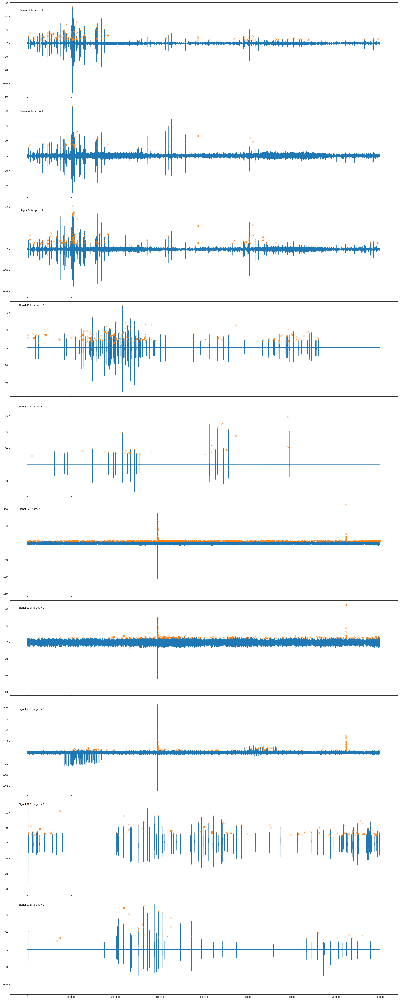

In [92]:
n=nn
fig, axs = plt.subplots(n, 1, figsize=(24, 6*n), facecolor='w', edgecolor='k', sharex=True)
plt.tight_layout()
axs = axs.ravel()
for i, j in enumerate(i_signals_1[:n]):
    peaks, _ = find_peaks(hp_1_d.values[i, :], height=5)
    axs[i].plot(hp_1_d.values[i, :])
    axs[i].plot(peaks, hp_1_d.values[i, :][peaks],"x")
    axs[i].text(10000, 0.90*max(hp_1.iloc[i, ].max(), hp_1_d.iloc[i, ].max()), f'Signal {j}: target = {meta_tr.iloc[j, :].target}', horizontalalignment='center', verticalalignment='center')

### Testing: interactive plots (nice for zooming in)

In [97]:
import bokeh.plotting as bp

In [100]:
xs = np.arange(hp_0_d.shape[1])

#### Target = 0

In [127]:
p = bp.figure(width=1600, height=400)
i = 8
j = i_signals_0[i]
peaks, _ = find_peaks(hp_0_d.values[i, :], height=5)
p.line(xs, hp_0_d.values[i, :], legend = f'Signal {j}: target = {meta_tr.iloc[j, :].target}', line_color='blue')
p.circle(peaks, hp_0_d.values[i, peaks], size=5, color="orange", alpha=0.5)
output_notebook()
show(p)

Loading BokehJS ...

#### Target = 1

In [129]:
p = bp.figure(width=1600, height=400)
i = 0
j = i_signals_1[i]
peaks, _ = find_peaks(hp_1_d.values[i, :], height=5)
p.line(xs, hp_1_d.values[i, :], legend = f'Signal {j}: target = {meta_tr.iloc[j, :].target}', line_color='blue')
p.circle(peaks, hp_1_d.values[i, peaks], size=5, color="orange", alpha=0.5)
output_notebook()
show(p)

Loading BokehJS ...

### Peak widths

In [75]:
testing = hp_d[495800:496000]

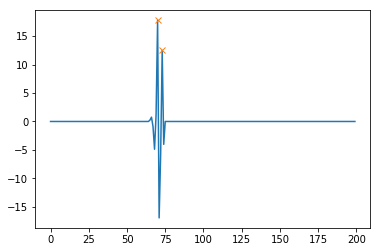

In [76]:
peaks, _ = find_peaks(testing, height=3)
results_half = peak_widths(testing, peaks, rel_height=0.5)
plt.plot(testing)
plt.plot(peaks, testing[peaks], "x")
plt.hlines(*results_half[1:], color="C2")

In [46]:
results_half = peak_widths(hp_d, peaks, rel_height=0.5)
#results_full = peak_widths(hp_d, peaks, rel_height=1)

In [ ]:
peaks_all = []
for i in range(hp_d.shape[0]):
    peaks, _ = find_peaks(hp_d.iloc[i,], height=5)
    peaks_all.append(peaks)